<a href="https://colab.research.google.com/github/Affog7/Gan-anim/blob/main/notebooks/animeGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dépôt git du projet

In [ ]:
from google.colab import drive, output
import torch
dv = torch.cuda.get_device_name(0)
print(dv)

drive.mount('/content/drive', force_remount=False)
repo = "Gan-anim" # Définir le nom du dépôt GitHub à cloner et naviguer dans le répertoire principal de Colab
%cd "/content"
!rm -rf {repo} # Supprimer le répertoire s'il existe déjà et cloner le dépôt
!git clone https://github.com/Affog7/{repo}
%cd {repo}
output.clear()

# Dataset

In [ ]:
import os
import urllib

data_path = 'anime-gan.zip'
dataset_url = 'https://github.com/ptran1203/pytorch-animeGAN/releases/download/v1.0/dataset_v1.zip'

if not os.path.exists("/content/dataset"):
    !wget -O {data_path} {dataset_url}
    !unzip {data_path} -d /content
    !rm {data_path}

    if not os.path.exists("/content/dataset"):
        raise ValueError(f"Download Failed, {data_path}")

output.clear()

In [ ]:
working_dir = '/content/drive/MyDrive/animeGAN'
print(f"You're running on {dv}")

You're running on Tesla T4


# Entraînement du modèle

In [ ]:
!python3 train.py --real_image_dir '/content/dataset/train_photo'\
                  --anime_image_dir '/content/dataset/Hayao'\
                  --batch 8\
                  --model v2\
                  --amp --cache\
                  --init_epochs 10\
                  --exp_dir {working_dir}\
                  --gan_loss lsgan\
                  --init_lr 0.0001\
                  --lr_g 0.00002\
                  --lr_d 0.00004\
                  --wadvd 300.0\
                  --wadvg 300.0\
                  --wcon 1.5\
                  --wgra 3.0\
                  --wcol 70.0\
                  --use_sn

#Explication du Commande pour entraîner le modèle AnimeGAN avec les paramètres spécifiés

                  --real_image_dir '/content/dataset/train_photo'\  
                  # Répertoire contenant les images réelles (photos) utilisées pour entraîner le modèle

                  --anime_image_dir '/content/dataset/Hayao'\
                  # Répertoire contenant les images de style anime utilisées pour entraîner le modèle

                  --batch 8\
                  # Taille du batch, détermine combien d'images sont traitées en même temps pendant l'entraînement

                  --model v2\
                  # Version du modèle à utiliser pour l'entraînement, ici la version 2

                  --amp --cache\
                  # Utilisation de l'Automatic Mixed Precision (AMP) pour accélérer l'entraînement en utilisant moins de mémoire
                  # et l'option cache pour stocker les données intermédiaires afin d'accélérer le processus

                  --init_epochs 10\
                  # Nombre d'époques d'initialisation pour entraîner le modèle avant d'affiner davantage

                  --exp_dir {working_dir}\
                  # Répertoire de destination où les résultats de l'entraînement (modèles, journaux) seront sauvegardés

                  --gan_loss lsgan\
                  # Type de fonction de perte GAN à utiliser, ici LSGAN (Least Squares GAN) pour une stabilité accrue

                  --init_lr 0.0001\
                  # Taux d'apprentissage initial pour la phase d'initialisation

                  --lr_g 0.00002\
                  # Taux d'apprentissage pour le générateur pendant l'entraînement

                  --lr_d 0.00004\
                  # Taux d'apprentissage pour le discriminateur pendant l'entraînement

                  --wadvd 300.0\
                  # Poids de la perte adversariale pour le discriminateur

                  --wadvg 300.0\
                  # Poids de la perte adversariale pour le générateur

                  --wcon 1.5\
                  # Poids de la perte de consistance de contenu pour assurer que le contenu de l'image reste cohérent

                  --wgra 3.0\
                  # Poids de la perte de gradient pour améliorer les transitions de couleur et les détails fins

                  --wcol 70.0\
                  # Poids de la perte de correspondance des couleurs pour aligner les couleurs des images générées avec celles du style cible

                  --use_sn
                  # Utilisation de la normalisation spectrale pour stabiliser le processus d'entraînement en régularisant les couches du modèle


In [ ]:
!pip install color_transfer

  Preparing metadata (setup.py) ... done
  Created wheel for color_transfer: filename=color_transfer-0.1-py3-none-any.whl size=2363 sha256=0d60dc0f66e5f32a48a75a6bd004629d3b0db668c0a73985e055a636b7172818
  Stored in directory: /root/.cache/pip/wheels/c2/84/dd/ae70281354692167c0f4bdd4a231c1b681fb4354124bb7f99d
Successfully built color_transfer


# Importation du module de prédiction et initialisation du prédicteur avec le chemin du modèle généré


In [ ]:
from inference import Predictor
predictor = Predictor("/content/drive/MyDrive/animeGAN_train_photo_Hayao/GeneratorV2_train_photo_Hayao.pt")

Use GPU Tesla T4


# Traitement d'images et l'affichage avec le modèle


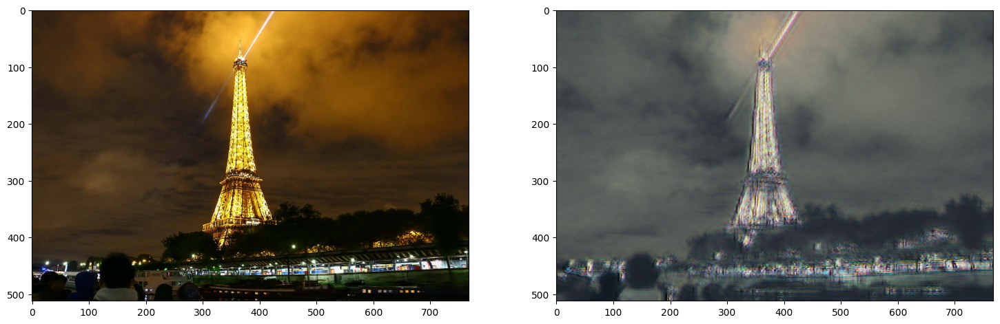

In [ ]:
import cv2
import random
import matplotlib.pyplot as plt
import numpy as np

# Fonction pour sélectionner une image aléatoire dans un répertoire

def random_img(img_dir):
    p = os.path.join(img_dir, random.choice(os.listdir(img_dir)))
    return cv2.imread(p)[:, :, ::-1]

# Charger une image de test et la redimensionner

image = random_img('/content/dataset/test/HR_photo')
image = cv2.resize(image, (768, 512))

# Transformer l'image en style anime avec le modèle

anime_img = (predictor.transform(image) + 1)

fig = plt.figure(figsize=(18, 25))
fig.add_subplot(1, 2, 1)
plt.imshow(image)
fig.add_subplot(1, 2, 2)
plt.imshow(anime_img[0])
plt.show()

# Inference Image

In [ ]:
# Commande pour effectuer l'inférence sur un dossier d'images et stocker les résultats

!python3 inference_image.py --checkpoint /content/drive/MyDrive/animeGAN_train_photo_Hayao/GeneratorV2_train_photo_Hayao.pt\
                            --src /content/dataset/test/HR_photo\
                            --dest inference_shinkai

Use GPU Tesla T4
Found 45 images in /content/dataset/test/HR_photo
1 (54) (832, 1280, 3): 100% 45/45 [00:35<00:00,  1.26it/s]
Processed in 35.755s


# Affichage des resultats

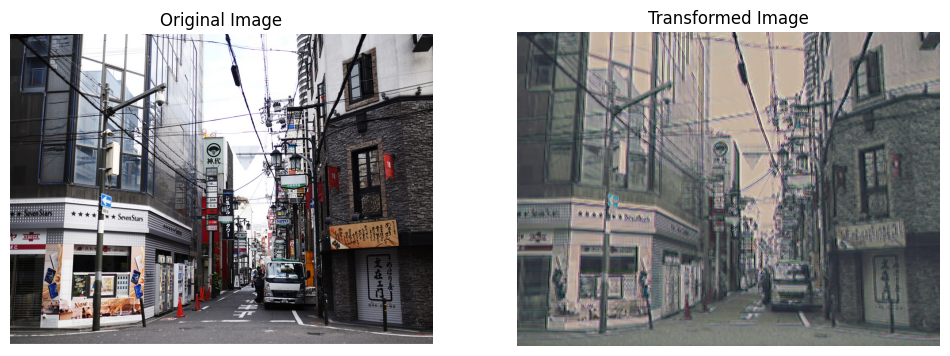

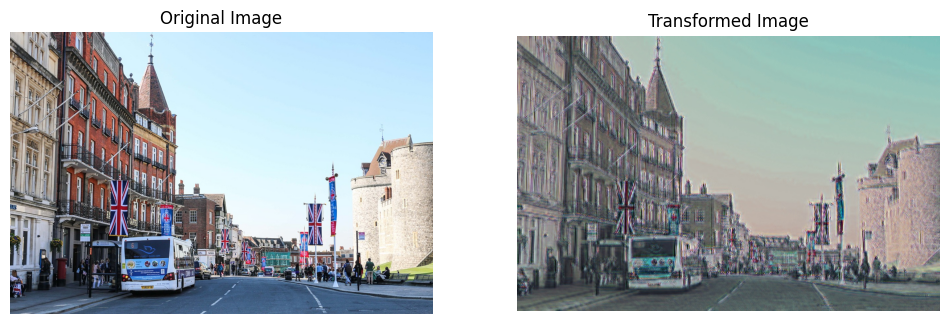

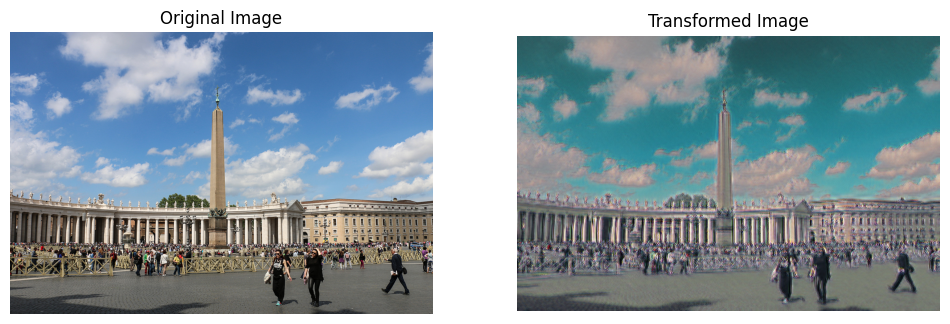

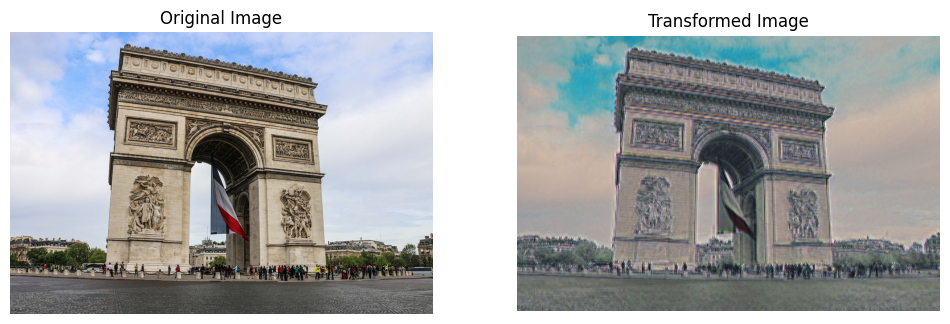

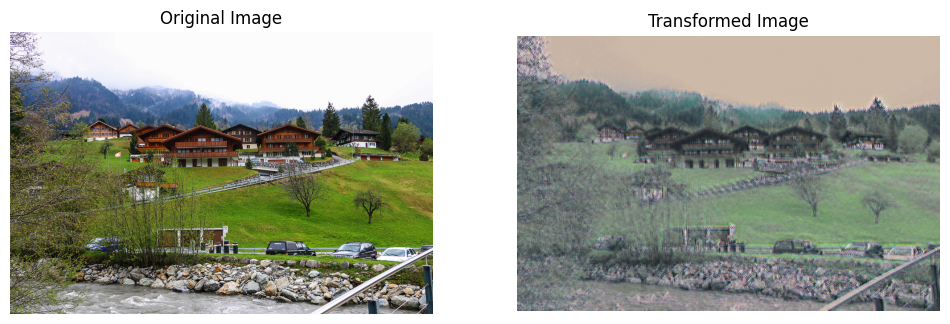

...

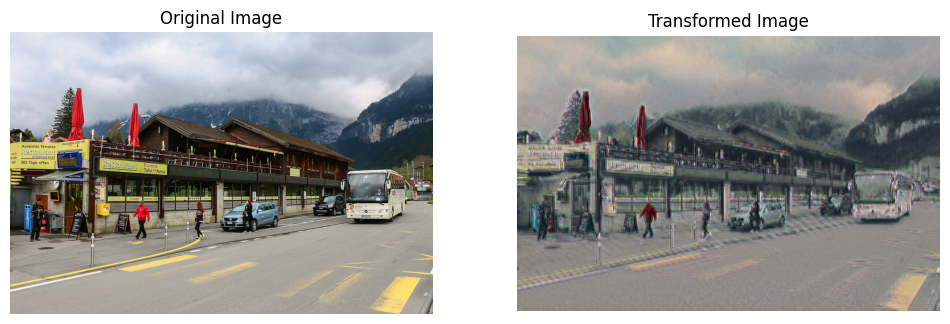

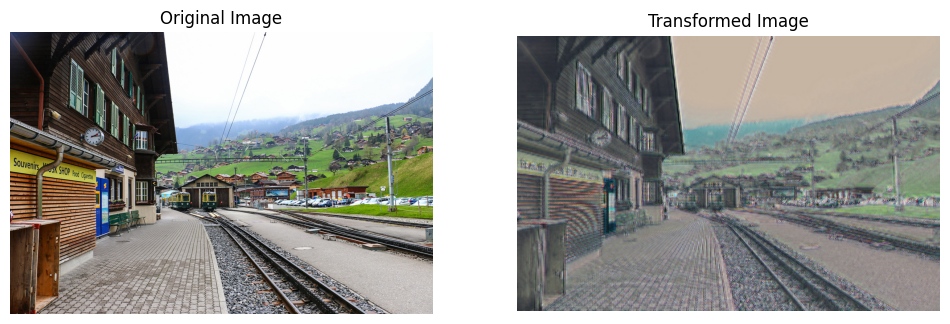

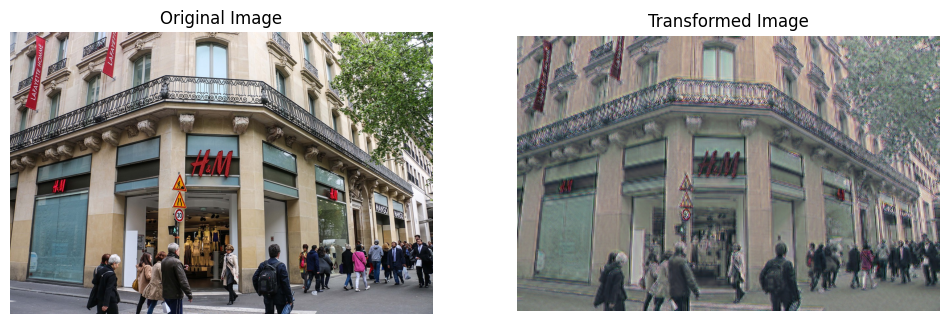

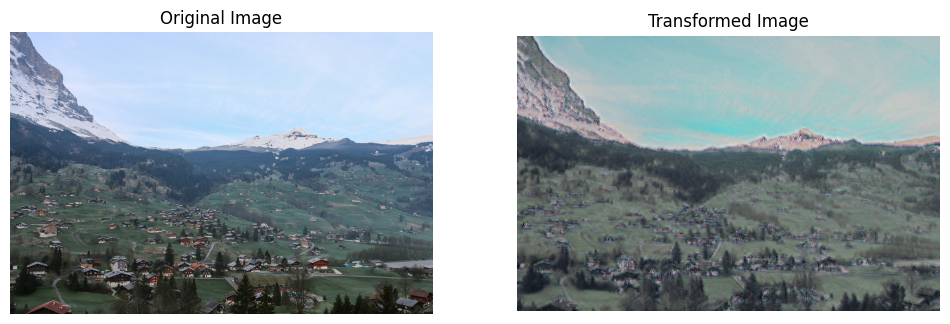

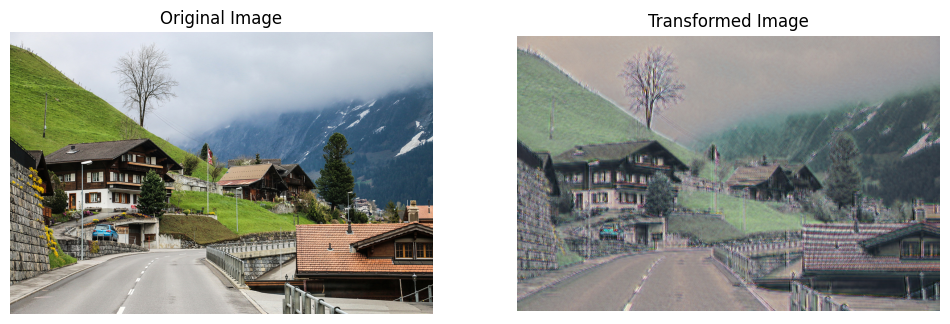

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Chemin des dossiers d'images d'origine et transformées
original_folder = '/content/dataset/test/HR_photo'
transformed_folder = '/content/Pytorch-animeGAN/inference_shinkai'

# Fonction pour afficher les images originales et transformées côte à côte
def display_images_side_by_side(original_folder, transformed_folder):
    # Liste des fichiers d'images
    original_files = sorted([f for f in os.listdir(original_folder) if f.endswith(('png', 'jpg', 'jpeg'))])
    transformed_files = sorted([f for f in os.listdir(transformed_folder) if f.endswith(('png', 'jpg', 'jpeg'))])

    # Vérification que les deux dossiers contiennent le même nombre d'images
    if len(original_files) != len(transformed_files):
        print("Le nombre d'images dans les dossiers ne correspond pas.")
        return

    # Affichage des images côte à côte
    for original_file, transformed_file in zip(original_files, transformed_files):
        original_img = cv2.imread(os.path.join(original_folder, original_file))
        transformed_img = cv2.imread(os.path.join(transformed_folder, transformed_file))

        # Convertir de BGR à RGB pour l'affichage avec Matplotlib
        original_img_rgb = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        transformed_img_rgb = cv2.cvtColor(transformed_img, cv2.COLOR_BGR2RGB)

        # Afficher côte à côte
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.title('Original Image')
        plt.imshow(original_img_rgb)
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.title('Transformed Image')
        plt.imshow(transformed_img_rgb)
        plt.axis('off')

        plt.show()

# Exécuter l'affichage des images côte à côte
display_images_side_by_side(original_folder, transformed_folder)


Inference video

In [ ]:
# Commande pour effectuer l'inférence sur une vidéo et stocker le résultat transformé

!python3 inference_video.py --checkpoint /content/drive/MyDrive/animeGAN_train_photo_Hayao/GeneratorV2_train_photo_Hayao.pt\
                            --src /content/Gan-anim/Video/giphy.mp4\
                            --dest /content/Gan-anim/Video/test_vid_3_anime.mp4\
                            --batch-size 2

Use GPU Tesla T4
Transfroming video /content/Gan-anim/Video/giphy.mp4, 80 frames, size: [480, 270]
100% 80/80 [00:05<00:00, 13.40it/s]
Animation video saved to /content/Gan-anim/Video/test_vid_3_anime.mp4


In [ ]:
import cv2

# Fonction pour afficher deux vidéos côte à côte et sauvegarder le résultat
def display_videos_side_by_side(video1_path, video2_path, output_path):
    # Capture des deux vidéos
    cap1 = cv2.VideoCapture(video1_path)
    cap2 = cv2.VideoCapture(video2_path)

    # Vérification si les vidéos peuvent être ouvertes
    if not cap1.isOpened() or not cap2.isOpened():
        print("Error opening one of the video files")
        return

    # Obtenir les propriétés des vidéos
    fps = int(cap1.get(cv2.CAP_PROP_FPS))
    width1 = int(cap1.get(cv2.CAP_PROP_FRAME_WIDTH))
    height1 = int(cap1.get(cv2.CAP_PROP_FRAME_HEIGHT))
    width2 = int(cap2.get(cv2.CAP_PROP_FRAME_WIDTH))
    height2 = int(cap2.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Redimensionner la deuxième vidéo pour qu'elle ait la même hauteur que la première
    width2_resized = int(width2 * (height1 / height2))

    # Définir le codec et créer le fichier de sortie
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width1 + width2_resized, height1))

    while cap1.isOpened() and cap2.isOpened():
        ret1, frame1 = cap1.read()
        ret2, frame2 = cap2.read()

        if not ret1 or not ret2:
            break

        # Redimensionner la deuxième frame
        frame2_resized = cv2.resize(frame2, (width2_resized, height1))

        # Concaténer les deux frames horizontalement
        combined_frame = cv2.hconcat([frame1, frame2_resized])

        # Écrire la frame combinée dans la sortie
        out.write(combined_frame)

    # Libération des objets vidéo
    cap1.release()
    cap2.release()
    out.release()
    print(f"Video saved at {output_path}")

# Exécutez la fonction avec les chemins de vos vidéos
display_videos_side_by_side(
    '/content/Gan-anim/Video/giphy.mp4',
    '/content/Gan-anim/Video/test_vid_3_anime.mp4',
    '/content/Gan-anim/Video/combined_video.mp4'
)


Video saved at /content/dataset/test/Video/combined_video.mp4


In [ ]:
from IPython.display import Video


# Lecture du fichier vidéo
video_path = '/content/Gan-anim/Video/combined_video.mp4'

Video(video_path)
